<a href="https://colab.research.google.com/github/neehasajja/waymo-opendataset/blob/main/hkp.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import pyarrow.parquet as pq
import pandas as pd

# Set the path to the Parquet file
parquet_file_path = '/content/drive/MyDrive/validation/camera_hkp/30779396576054160_1880_000_1900_000.parquet'

# Read the Parquet file into a Pyarrow table
table = pq.read_table(parquet_file_path)

# Convert the table to a Pandas DataFrame
df = table.to_pandas()

# Print the first 10 rows of the DataFrame
print(df.head(10))
print(df.columns)

                                                               key.segment_context_name  \
index                                                                                     
30779396576054160_1880_000_1900_000;15578450726...  30779396576054160_1880_000_1900_000   
30779396576054160_1880_000_1900_000;15578450726...  30779396576054160_1880_000_1900_000   
30779396576054160_1880_000_1900_000;15578450726...  30779396576054160_1880_000_1900_000   
30779396576054160_1880_000_1900_000;15578450726...  30779396576054160_1880_000_1900_000   
30779396576054160_1880_000_1900_000;15578450726...  30779396576054160_1880_000_1900_000   
30779396576054160_1880_000_1900_000;15578450726...  30779396576054160_1880_000_1900_000   
30779396576054160_1880_000_1900_000;15578450726...  30779396576054160_1880_000_1900_000   
30779396576054160_1880_000_1900_000;15578450726...  30779396576054160_1880_000_1900_000   
30779396576054160_1880_000_1900_000;15578450726...  30779396576054160_1880_000_1900_000   

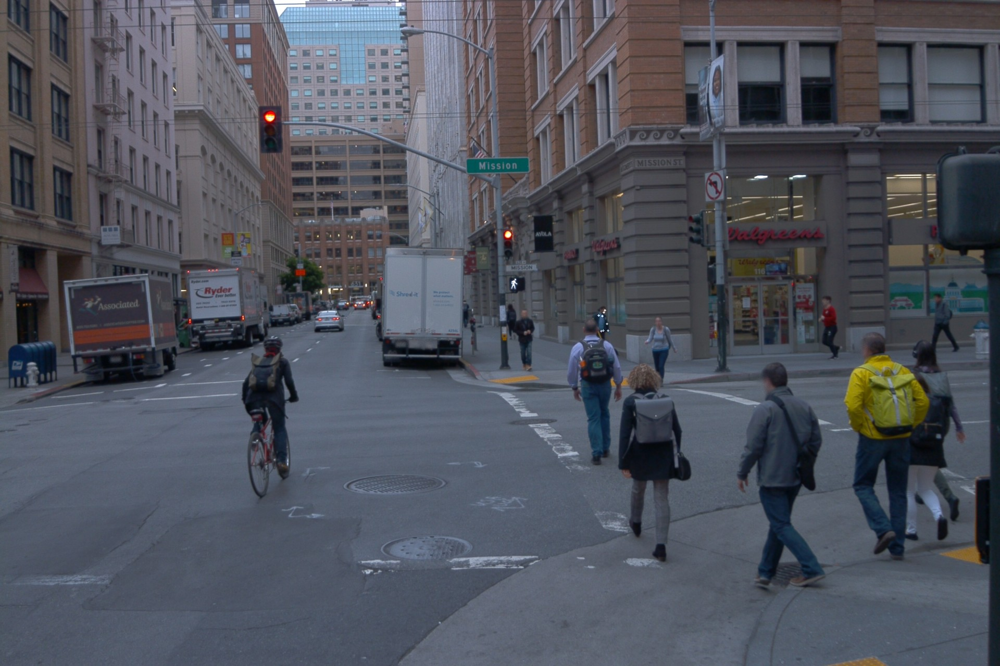

In [ ]:
import cv2
import pandas as pd
import numpy as np
from google.colab.patches import cv2_imshow

# Set the timestamp, camera name, and object ID to mark the keypoints on
timestamp = 1557845072664263
camera_name = 1
object_id = 'b3a2301c-7793-4a8b-a84f-72611503b537'

# Read the camera image data
image_file = '/content/drive/MyDrive/validation/camera_image/file1.parquet'
image_data = pd.read_parquet(image_file)
image_bytes = image_data['[CameraImageComponent].image'][0]

# Create an image array from the bytes data
image = np.array(bytearray(image_bytes), dtype=np.uint8)
image = cv2.imdecode(image, cv2.IMREAD_COLOR)

# Load the camera_hkp_data
camera_hkp_file = '/content/drive/MyDrive/validation/camera_hkp/30779396576054160_1880_000_1900_000.parquet'
camera_hkp_data = pd.read_parquet(camera_hkp_file)

# Filter the camera_hkp_data based on the timestamp, camera name, and object ID
filtered_hkp_data = camera_hkp_data[
    (camera_hkp_data['key.frame_timestamp_micros'] == timestamp) &
    (camera_hkp_data['key.camera_name'] == camera_name) &
    (camera_hkp_data['key.camera_object_id'] == object_id)
]

# Access the x and y coordinates of the human keypoints
x = filtered_hkp_data.explode('[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x')[
    '[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x'].values
y = filtered_hkp_data.explode('[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y')[
    '[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y'].values

# Check if keypoints are present
if len(x) == 0 or len(y) == 0:
    raise ValueError("No human keypoints found for the specified object")

# Create an empty mask image
mask = np.zeros_like(image)

# Draw keypoints on the mask image
for i in range(len(x)):
    cv2.circle(mask, (int(x[i]), int(y[i])), 2, (255, 255, 255), -1)

# Apply the mask to the original image
result = cv2.addWeighted(image, 1, mask, 0.6, 0)

# Display the resulting image
cv2_imshow(result)

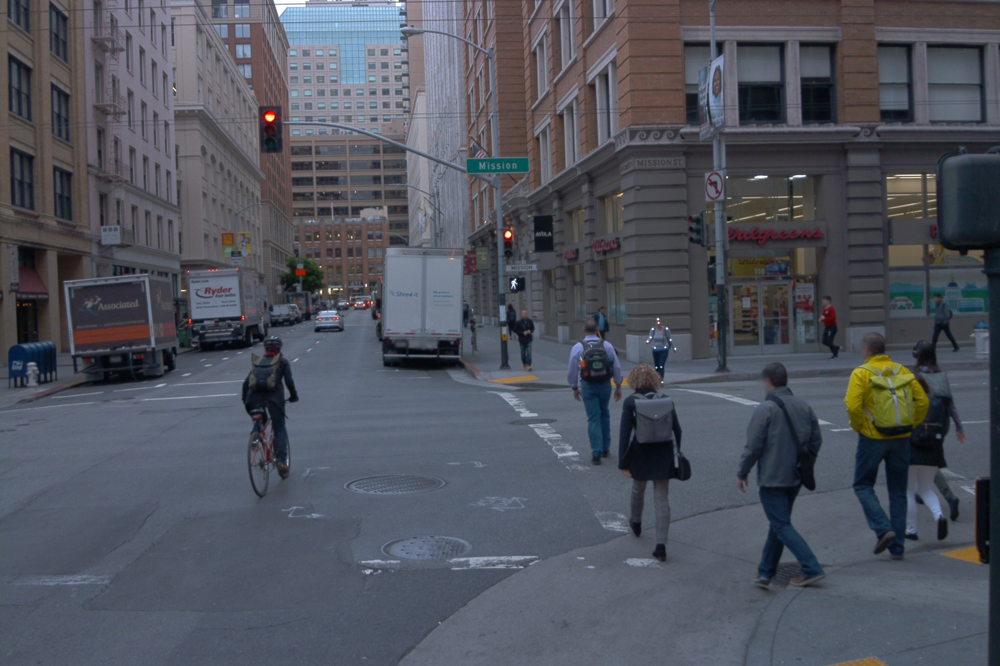

In [ ]:
import cv2
import pandas as pd
import numpy as np
from google.colab.patches import cv2_imshow

# Set the timestamp, camera name, and object ID to mark the keypoints on
timestamp = 1557845072664263
camera_name = 1
object_id = '1b660186-6119-45b5-8d6b-541b9a72c812'

# Read the camera image data
image_file = '/content/drive/MyDrive/validation/camera_image/file1.parquet'
image_data = pd.read_parquet(image_file)
image_bytes = image_data['[CameraImageComponent].image'][0]

# Create an image array from the bytes data
image = np.array(bytearray(image_bytes), dtype=np.uint8)
image = cv2.imdecode(image, cv2.IMREAD_COLOR)

# Load the camera_hkp_data
camera_hkp_file = '/content/drive/MyDrive/validation/camera_hkp/30779396576054160_1880_000_1900_000.parquet'
camera_hkp_data = pd.read_parquet(camera_hkp_file)


# Check if keypoints are present
if len(x) == 0 or len(y) == 0:
    raise ValueError("No human keypoints found for the specified object")

# Create an empty mask image
mask = np.zeros_like(image)

# Draw keypoints on the mask image
for i in range(len(x)):
    cv2.circle(mask, (int(x[i]), int(y[i])), 2, (255, 255, 255), -1)

# Apply the mask to the original image
result = cv2.addWeighted(image, 1, mask, 0.6, 0)

# Display the resulting image
cv2_imshow(result)


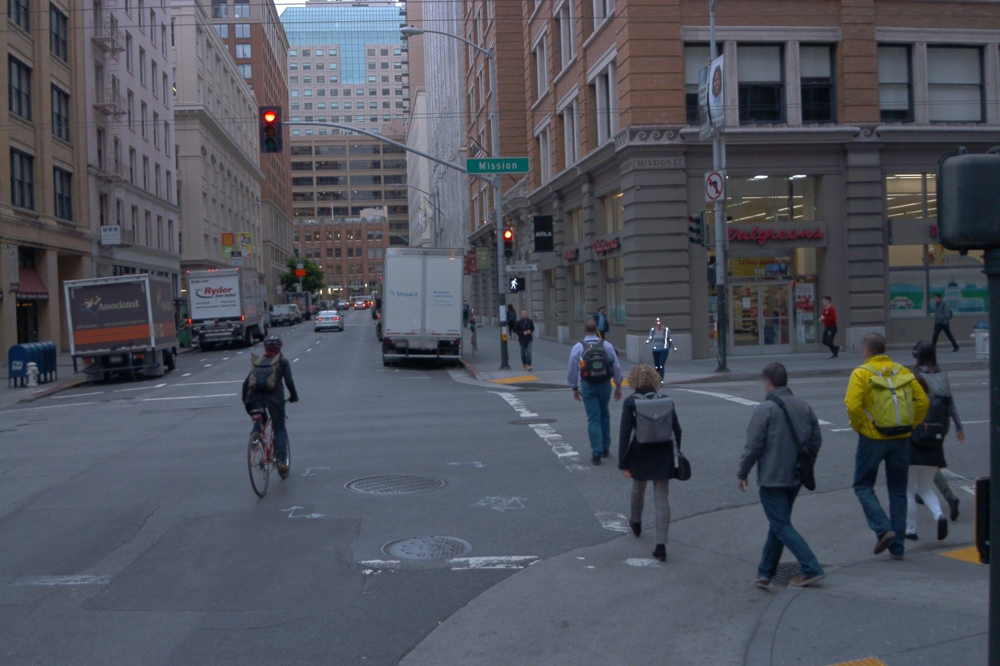

In [ ]:
import cv2
import pandas as pd
import numpy as np
from google.colab.patches import cv2_imshow

# Set the timestamp, camera name, and object ID to mark the keypoints on
timestamp = 1557845072664263
camera_name = 1
object_id = '1b660186-6119-45b5-8d6b-541b9a72c812'


# Read the camera image data
image_file = '/content/drive/MyDrive/validation/camera_image/file1.parquet'
image_data = pd.read_parquet(image_file)
image_bytes = image_data['[CameraImageComponent].image'][0]

# Create an image array from the bytes data
image = np.array(bytearray(image_bytes), dtype=np.uint8)
image = cv2.imdecode(image, cv2.IMREAD_COLOR)

# Load the camera_hkp_data
camera_hkp_file = '/content/drive/MyDrive/validation/camera_hkp/30779396576054160_1880_000_1900_000.parquet'
camera_hkp_data = pd.read_parquet(camera_hkp_file)

# Filter the camera_hkp_data based on the timestamp, camera name, and object ID
filtered_hkp_data = camera_hkp_data[
    (camera_hkp_data['key.frame_timestamp_micros'] == timestamp) &
    (camera_hkp_data['key.camera_name'] == camera_name) &
    (camera_hkp_data['key.camera_object_id'] == object_id)
]

# Access the x and y coordinates of the human keypoints
x = filtered_hkp_data.explode('[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x')[
    '[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x'].values
y = filtered_hkp_data.explode('[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y')[
    '[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y'].values

# Check if keypoints are present
if len(x) == 0 or len(y) == 0:
    raise ValueError("No human keypoints found in the data")

# Create an empty mask image
mask = np.zeros_like(image)

# Draw keypoints on the mask image
for i in range(len(x)):
    cv2.circle(mask, (int(x[i]), int(y[i])), 2, (255, 255, 255), -1)

# Define the keypoint types
keypoint_types = np.array([8, 5, 17, 7, 16, 19, 1, 10, 9, 13, 6, 15, 14])

# Define the connections between keypoints based on their types
connections = []
if np.isin(8, keypoint_types) and np.isin(5, keypoint_types):
    connections.append((np.where(keypoint_types == 8)[0][0], np.where(keypoint_types == 5)[0][0]))

# Draw the skeleton on the mask image
for connection in connections:
    idx1, idx2 = connection
    cv2.line(mask, (int(x[idx1]), int(y[idx1])), (int(x[idx2]), int(y[idx2])), (255, 255, 255), 2)

# Apply the mask to the original image
result = cv2.addWeighted(image, 1, mask, 0.6, 0)

# Display the resulting image
cv2_imshow(result)

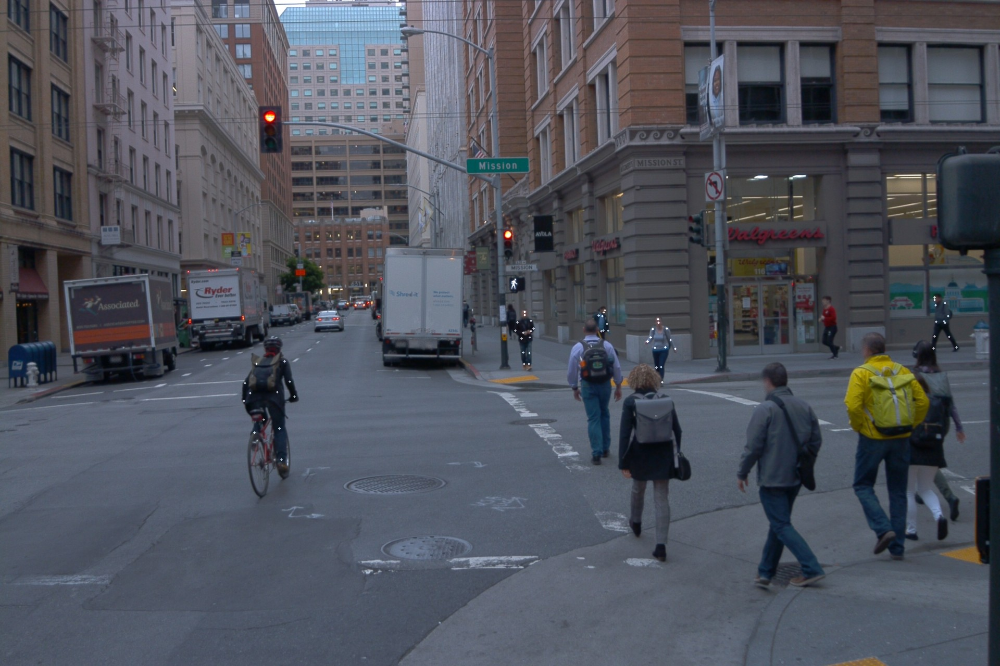

In [ ]:

import cv2
import pandas as pd
import numpy as np
from google.colab.patches import cv2_imshow

# Set the timestamp and camera name to mark the keypoints on
timestamp = 1557845072664263
camera_name = 1

# Read the camera image data
image_file = '/content/drive/MyDrive/validation/camera_image/file1.parquet'
image_data = pd.read_parquet(image_file)
image_bytes = image_data['[CameraImageComponent].image'][0]

# Create an image array from the bytes data
image = np.array(bytearray(image_bytes), dtype=np.uint8)
image = cv2.imdecode(image, cv2.IMREAD_COLOR)

# Load the camera_hkp_data
camera_hkp_file = '/content/drive/MyDrive/validation/camera_hkp/30779396576054160_1880_000_1900_000.parquet'
camera_hkp_data = pd.read_parquet(camera_hkp_file)

# Filter the camera_hkp_data based on the timestamp and camera name
filtered_hkp_data = camera_hkp_data[
    (camera_hkp_data['key.frame_timestamp_micros'] == timestamp) &
    (camera_hkp_data['key.camera_name'] == camera_name)
]

# Create an empty mask image
mask = np.zeros_like(image)

# Iterate over each object ID in the filtered data
for object_id in filtered_hkp_data['key.camera_object_id'].unique():
    # Filter the data for the current object ID
    object_data = filtered_hkp_data[
        filtered_hkp_data['key.camera_object_id'] == object_id
    ]

    # Access the x and y coordinates of the human keypoints
    x = object_data.explode('[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x')[
        '[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x'].values
    y = object_data.explode('[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y')[
        '[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y'].values

    # Draw keypoints on the mask image
    for i in range(len(x)):
        cv2.circle(mask, (int(x[i]), int(y[i])), 2, (255, 255, 255), -1)

# Apply the mask to the original image
result = cv2.addWeighted(image, 1, mask, 0.6, 0)

# Display the resulting image
cv2_imshow(result)

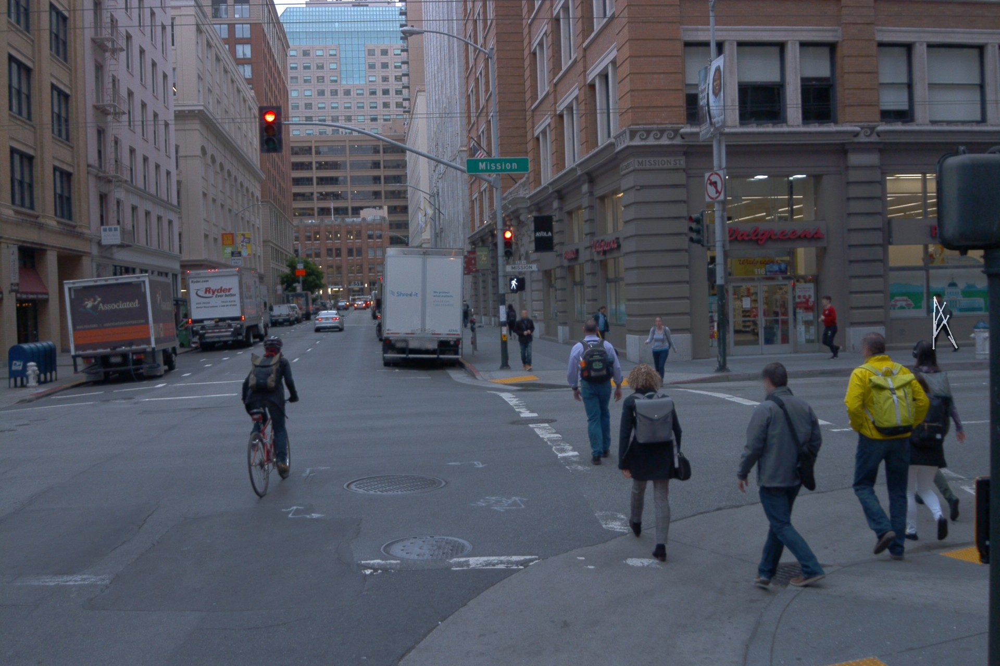

In [34]:
import cv2
import pandas as pd
import numpy as np
from google.colab.patches import cv2_imshow

# Set the timestamp and camera name to mark the keypoints on
timestamp = 1557845072664263
camera_name = 1

# Read the camera image data
image_file = '/content/drive/MyDrive/validation/camera_image/file1.parquet'
image_data = pd.read_parquet(image_file)
image_bytes = image_data['[CameraImageComponent].image'][0]

# Create an image array from the bytes data
image = np.array(bytearray(image_bytes), dtype=np.uint8)
image = cv2.imdecode(image, cv2.IMREAD_COLOR)

# Load the camera_hkp_data
camera_hkp_file = '/content/drive/MyDrive/validation/camera_hkp/30779396576054160_1880_000_1900_000.parquet'
camera_hkp_data = pd.read_parquet(camera_hkp_file)

# Filter the camera_hkp_data based on the timestamp and camera name
filtered_hkp_data = camera_hkp_data[
    (camera_hkp_data['key.frame_timestamp_micros'] == timestamp) &
    (camera_hkp_data['key.camera_name'] == camera_name)
]

# Create an empty mask image
mask = np.zeros_like(image)

# Iterate over each object ID in the filtered data
for object_id in filtered_hkp_data['key.camera_object_id'].unique():
    # Filter the data for the current object ID
    object_data = filtered_hkp_data[
        filtered_hkp_data['key.camera_object_id'] == object_id
    ]

    # Access the x and y coordinates of the human keypoints
    x = object_data.explode('[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x')[
        '[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x'].values
    y = object_data.explode('[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y')[
        '[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y'].values
# Draw keypoints on the mask image
for i in range(len(x)):
    cv2.circle(mask, (int(x[i]), int(y[i])), 2, (255, 255, 255), -1)

# Define the connections between keypoints for skeleton drawing
connections = [(0, 1), (1, 3), (0, 2), (2, 4), (5, 6), (5, 7), (7, 9), (6, 8), (8, 10), (11, 12), (11, 13), (13, 15),
               (12, 14), (14, 16)]

# Draw the skeleton lines between the keypoints
for connection in connections:
    if connection[0] < len(x) and connection[1] < len(x):
        cv2.line(mask, (int(x[connection[0]]), int(y[connection[0]])), (int(x[connection[1]]), int(y[connection[1]])),
                 (255, 255, 255), 2)

# Apply the mask to the original image
result = cv2.addWeighted(image, 1, mask, 0.6, 0)

# Display the resulting image
cv2_imshow(result)

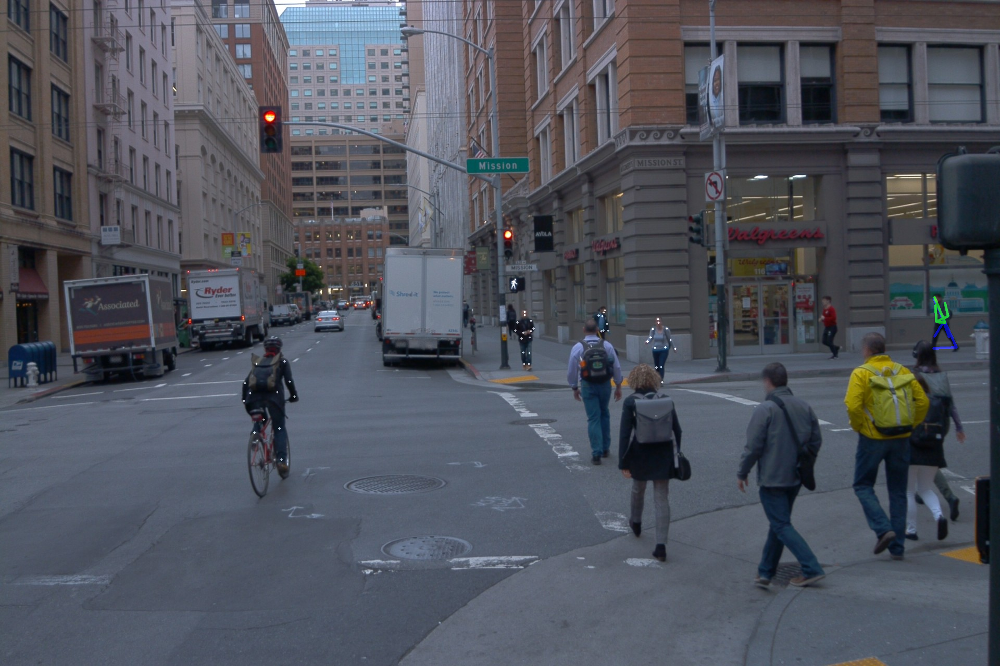

In [46]:
import cv2
import pandas as pd
import numpy as np
from google.colab.patches import cv2_imshow

# Set the timestamp and camera name to mark the keypoints on
timestamp = 1557845072664263
camera_name = 1

# Read the camera image data
image_file = '/content/drive/MyDrive/validation/camera_image/file1.parquet'
image_data = pd.read_parquet(image_file)
image_bytes = image_data['[CameraImageComponent].image'][0]

# Create an image array from the bytes data
image = np.array(bytearray(image_bytes), dtype=np.uint8)
image = cv2.imdecode(image, cv2.IMREAD_COLOR)

# Load the camera_hkp_data
camera_hkp_file = '/content/drive/MyDrive/validation/camera_hkp/30779396576054160_1880_000_1900_000.parquet'
camera_hkp_data = pd.read_parquet(camera_hkp_file)

# Filter the camera_hkp_data based on the timestamp and camera name
filtered_hkp_data = camera_hkp_data[
    (camera_hkp_data['key.frame_timestamp_micros'] == timestamp) &
    (camera_hkp_data['key.camera_name'] == camera_name)
]

# Create an empty mask image
mask = np.zeros_like(image)

## Iterate over each object ID in the filtered data
for object_id in filtered_hkp_data['key.camera_object_id'].unique():
    # Filter the data for the current object ID
    object_data = filtered_hkp_data[filtered_hkp_data['key.camera_object_id'] == object_id]

    # Access the x and y coordinates of the human keypoints
    x = object_data.explode('[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x')[
        '[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x'].values
    y = object_data.explode('[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y')[
        '[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y'].values

    # Draw keypoints on the mask image
    for i in range(len(x)):
        cv2.circle(mask, (int(x[i]), int(y[i])), 2, (255, 255, 255), -1)

    # Define the connections for the skeleton specific to this object
    connections = [(0, 1), (1, 2), (2, 3),  # Right arm
                   (0, 4), (4, 5), (5, 6),  # Left arm
                   (0, 7), (7, 8), (8, 9), (9, 10),  # Spine
                   (8, 11), (11, 12)]  # Neck and head


    # Draw the skeleton lines
for connection in connections:
    # Get the indices of the keypoints in the connection
    index1, index2 = connection

    # Check if the indices are within the range of available keypoints
    if index1 < len(x) and index2 < len(x):
        # Define different colors for different parts of the skeleton
        if connection in [(0, 1), (1, 2), (2, 3), (0, 4), (4, 5), (5, 6)]:
            color = (255, 0, 0)  # Red for arms
        elif connection in [(0, 7), (7, 8), (8, 9), (9, 10), (8, 11), (11, 12)]:
            color = (0, 255, 0)  # Green for spine and neck/head
        else:
            color = (0, 0, 255)  # Blue for other connections

        # Draw the skeleton line
        cv2.line(mask, (int(x[index1]), int(y[index1])), (int(x[index2]), int(y[index2])), color, 4)

# Apply the mask to the original image
result = cv2.addWeighted(image, 1, mask, 0.6, 0)

# Display the resulting image
cv2_imshow(result)


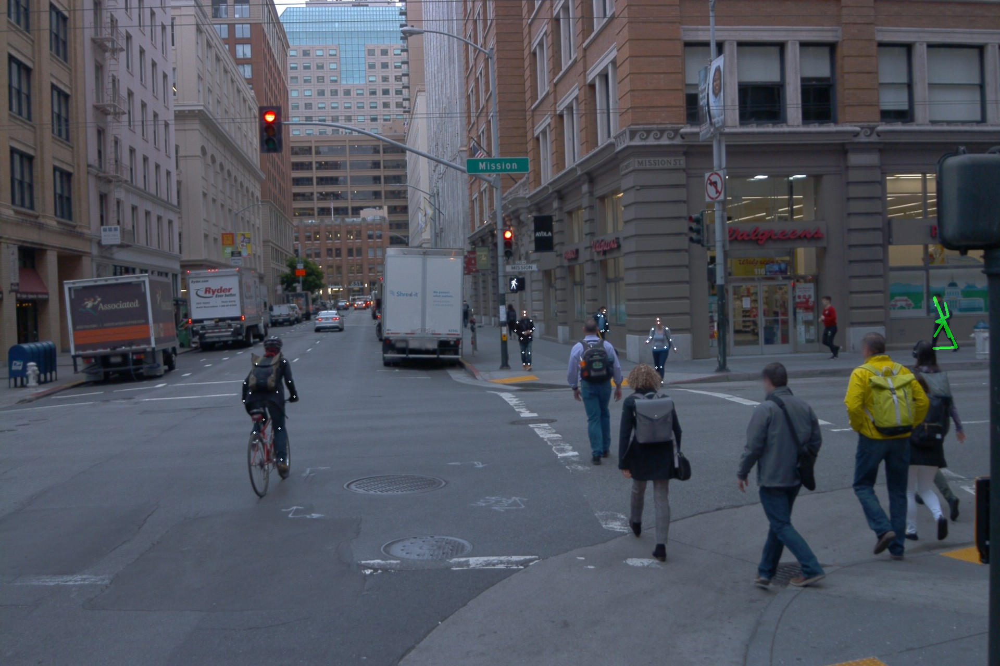

In [50]:

import cv2
import pandas as pd
import numpy as np
from google.colab.patches import cv2_imshow

# Set the timestamp and camera name to mark the keypoints on
timestamp = 1557845072664263
camera_name = 1

# Read the camera image data
image_file = '/content/drive/MyDrive/validation/camera_image/file1.parquet'
image_data = pd.read_parquet(image_file)
image_bytes = image_data['[CameraImageComponent].image'][0]

# Create an image array from the bytes data
image = np.array(bytearray(image_bytes), dtype=np.uint8)
image = cv2.imdecode(image, cv2.IMREAD_COLOR)

# Load the camera_hkp_data
camera_hkp_file = '/content/drive/MyDrive/validation/camera_hkp/30779396576054160_1880_000_1900_000.parquet'
camera_hkp_data = pd.read_parquet(camera_hkp_file)

# Filter the camera_hkp_data based on the timestamp and camera name
filtered_hkp_data = camera_hkp_data[
    (camera_hkp_data['key.frame_timestamp_micros'] == timestamp) &
    (camera_hkp_data['key.camera_name'] == camera_name)
]

# Create an empty mask image
mask = np.zeros_like(image)

# Iterate over each object ID in the filtered data
for object_id in filtered_hkp_data['key.camera_object_id'].unique():
    # Filter the data for the current object ID
    object_data = filtered_hkp_data[
        filtered_hkp_data['key.camera_object_id'] == object_id
    ]

    # Access the x and y coordinates of the human keypoints
    x = object_data.explode('[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x')[
        '[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x'].values
    y = object_data.explode('[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y')[
        '[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y'].values

    # Draw keypoints on the mask image
    for i in range(len(x)):
        cv2.circle(mask, (int(x[i]), int(y[i])), 2, (255, 255, 255), -1)

    # Define the connections for the skeleton
    connections = []

    # Right arm
    if len(x) >= 4:
        connections.extend([(0, 1), (1, 2), (2, 3)])

    # Left arm
    if len(x) >= 7:
        connections.extend([(0, 4), (4, 5), (5, 6)])

    # Spine
    if len(x) >= 11:
        connections.extend([(0, 7), (7, 8), (8, 9), (9, 10)])

    # Neck and head
    if len(x) >= 13:
        connections.extend([(8, 11), (11, 12)])

     #Draw the skeleton lines
for connection in connections:
    index1, index2 = connection

    if 0 <= index1 < len(x) and 0 <= index2 < len(x):
        cv2.line(mask, (int(x[index1]), int(y[index1])), (int(x[index2]), int(y[index2])), color, 4)

# Apply the mask to the original image
result = cv2.addWeighted(image, 1, mask, 0.6, 0)

# Display the resulting image
cv2_imshow(result)

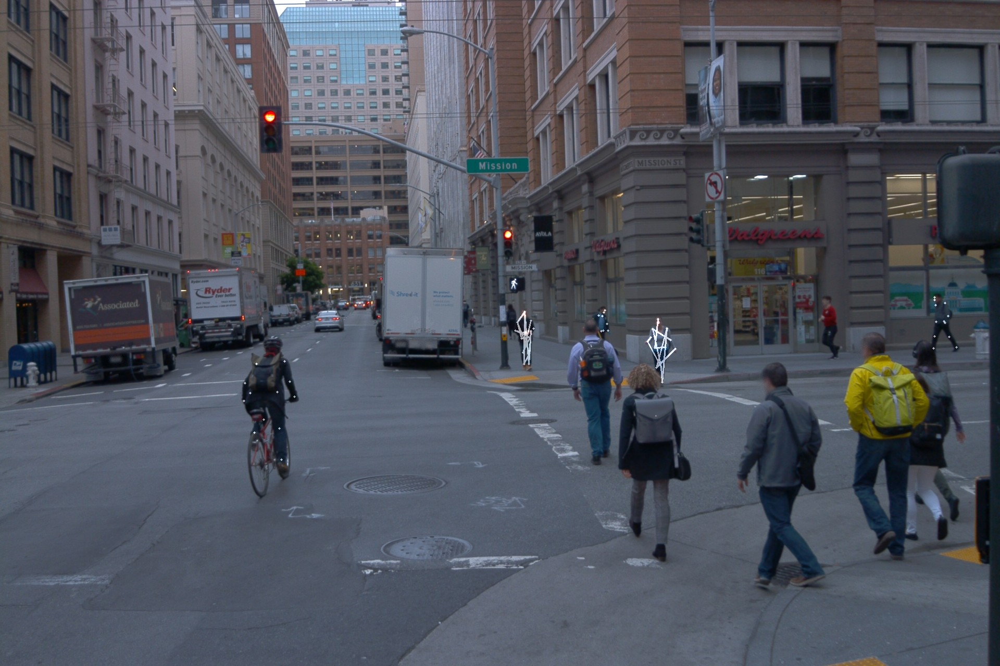

In [54]:
import cv2
import pandas as pd
import numpy as np
from google.colab.patches import cv2_imshow

# Set the timestamp and camera name to mark the keypoints on
timestamp = 1557845072664263
camera_name = 1

# Read the camera image data
image_file = '/content/drive/MyDrive/validation/camera_image/file1.parquet'
image_data = pd.read_parquet(image_file)
image_bytes = image_data['[CameraImageComponent].image'][0]

# Create an image array from the bytes data
image = np.array(bytearray(image_bytes), dtype=np.uint8)
image = cv2.imdecode(image, cv2.IMREAD_COLOR)

# Load the camera_hkp_data
camera_hkp_file = '/content/drive/MyDrive/validation/camera_hkp/30779396576054160_1880_000_1900_000.parquet'
camera_hkp_data = pd.read_parquet(camera_hkp_file)

# Filter the camera_hkp_data based on the timestamp and camera name
filtered_hkp_data = camera_hkp_data[
    (camera_hkp_data['key.frame_timestamp_micros'] == timestamp) &
    (camera_hkp_data['key.camera_name'] == camera_name)
]

# Create an empty mask image
mask = np.zeros_like(image)

# Define the connections for the skeleton
connections = [(0, 1), (1, 2), (2, 3),  # Right arm
               (0, 4), (4, 5), (5, 6),  # Left arm
               (0, 7), (7, 8), (8, 9), (9, 10),  # Spine
               (8, 11), (11, 12)]  # Neck and head

# Iterate over each object ID in the filtered data
for object_id in filtered_hkp_data['key.camera_object_id'].unique():
    # Filter the data for the current object ID
    object_data = filtered_hkp_data[
        filtered_hkp_data['key.camera_object_id'] == object_id
    ]

    # Access the x and y coordinates of the human keypoints
    x = object_data.explode('[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x')[
        '[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x'].values
    y = object_data.explode('[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y')[
        '[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y'].values

    # Draw the keypoints on the mask image
    for i in range(len(x)):
        cv2.circle(mask, (int(x[i]), int(y[i])), 2, (255, 255, 255), -1)

    # Check if the number of keypoints is sufficient for creating the skeleton
    if len(x) >= 13:
        # Draw the skeleton lines
        for connection in connections:
            index1, index2 = connection
            if index1 < len(x) and index2 < len(y):
                cv2.line(mask, (int(x[index1]), int(y[index1])), (int(x[index2]), int(y[index2])), (255, 255, 255), 2)

# Apply the mask to the original image
result = cv2.addWeighted(image, 1, mask, 0.6, 0)

# Display the resulting image
cv2_imshow(result)

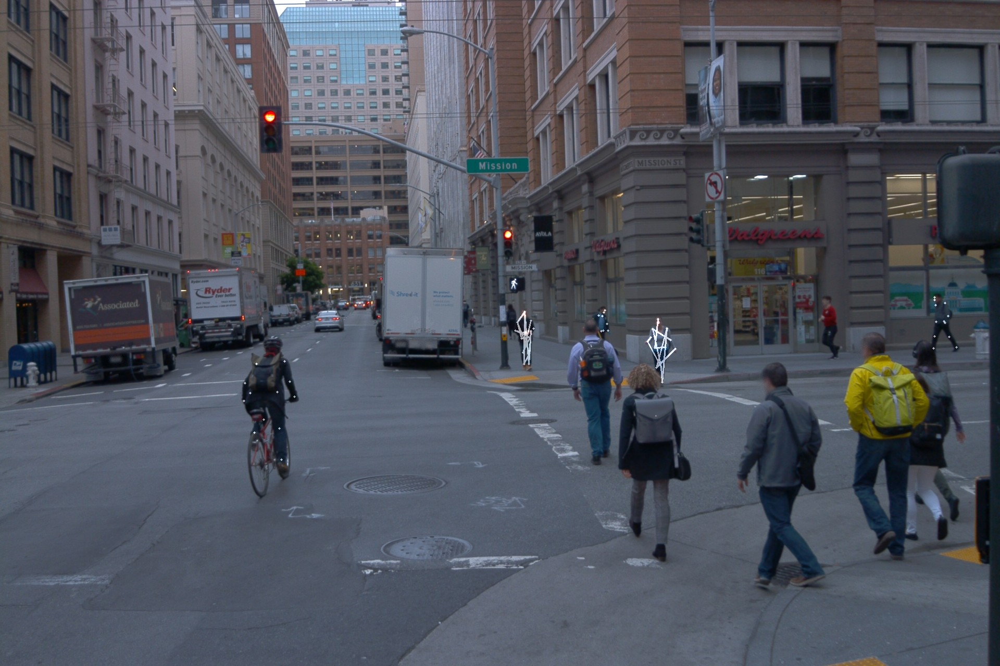

In [55]:
import cv2
import pandas as pd
import numpy as np
from google.colab.patches import cv2_imshow

# Set the timestamp and camera name to mark the keypoints on
timestamp = 1557845072664263
camera_name = 1

# Read the camera image data
image_file = '/content/drive/MyDrive/validation/camera_image/file1.parquet'
image_data = pd.read_parquet(image_file)
image_bytes = image_data['[CameraImageComponent].image'][0]

# Create an image array from the bytes data
image = np.array(bytearray(image_bytes), dtype=np.uint8)
image = cv2.imdecode(image, cv2.IMREAD_COLOR)

# Load the camera_hkp_data
camera_hkp_file = '/content/drive/MyDrive/validation/camera_hkp/30779396576054160_1880_000_1900_000.parquet'
camera_hkp_data = pd.read_parquet(camera_hkp_file)

# Filter the camera_hkp_data based on the timestamp and camera name
filtered_hkp_data = camera_hkp_data[
    (camera_hkp_data['key.frame_timestamp_micros'] == timestamp) &
    (camera_hkp_data['key.camera_name'] == camera_name)
]

# Create an empty mask image
mask = np.zeros_like(image)

# Define the connections for the skeleton
connections = [(0, 1), (1, 2), (2, 3),  # Right arm
               (0, 4), (4, 5), (5, 6),  # Left arm
               (0, 7), (7, 8), (8, 9), (9, 10),  # Spine
               (8, 11), (11, 12)]  # Neck and head

# Iterate over each object ID in the filtered data
for object_id in filtered_hkp_data['key.camera_object_id'].unique():
    # Filter the data for the current object ID
    object_data = filtered_hkp_data[
        filtered_hkp_data['key.camera_object_id'] == object_id
    ]

    # Access the x and y coordinates of the human keypoints
    x = object_data.explode('[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x')[
        '[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x'].values
    y = object_data.explode('[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y')[
        '[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y'].values

    # Draw the keypoints on the mask image
    for i in range(len(x)):
        cv2.circle(mask, (int(x[i]), int(y[i])), 2, (255, 255, 255), -1)

    # Check if the number of keypoints is sufficient for creating the skeleton
    if len(x) >= 13:
        # Draw the skeleton lines
        for connection in connections:
            index1, index2 = connection
            if index1 < len(x) and index2 < len(y):
                cv2.line(mask, (int(x[index1]), int(y[index1])), (int(x[index2]), int(y[index2])), (255, 255, 255), 2)

# Apply the mask to the original image
result = cv2.addWeighted(image, 1, mask, 0.6, 0)

# Display the resulting image
cv2_imshow(result)

In [ ]:

import cv2
import pandas as pd
import numpy as np
from google.colab.patches import cv2_imshow

# Set the timestamp and camera name to mark the keypoints on
timestamp = 1557845072664263
camera_name = 1

# Read the camera image data
image_file = '/content/drive/MyDrive/validation/camera_image/file1.parquet'
image_data = pd.read_parquet(image_file)
image_bytes = image_data['[CameraImageComponent].image'][0]

# Create an image array from the bytes data
image = np.array(bytearray(image_bytes), dtype=np.uint8)
image = cv2.imdecode(image, cv2.IMREAD_COLOR)

# Load the camera_hkp_data
camera_hkp_file = '/content/drive/MyDrive/validation/camera_hkp/30779396576054160_1880_000_1900_000.parquet'
camera_hkp_data = pd.read_parquet(camera_hkp_file)

# Filter the camera_hkp_data based on the timestamp and camera name
filtered_hkp_data = camera_hkp_data[
    (camera_hkp_data['key.frame_timestamp_micros'] == timestamp) &
    (camera_hkp_data['key.camera_name'] == camera_name)
]

# Create an empty mask image
mask = np.zeros_like(image)

# Iterate over each object ID in the filtered data
for object_id in filtered_hkp_data['key.camera_object_id'].unique():
    # Filter the data for the current object ID
    object_data = filtered_hkp_data[
        filtered_hkp_data['key.camera_object_id'] == object_id
    ]

    # Access the x and y coordinates of the human keypoints
    x = object_data.explode('[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x')[
        '[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x'].values
    y = object_data.explode('[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y')[
        '[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y'].values

    # Draw keypoints on the mask image
    for i in range(len(x)):
        cv2.circle(mask, (int(x[i]), int(y[i])), 2, (255, 255, 255), -1)

# Apply the mask to the original image
result = cv2.addWeighted(image, 1, mask, 0.6, 0)

# Display the resulting image
cv2_imshow(result)

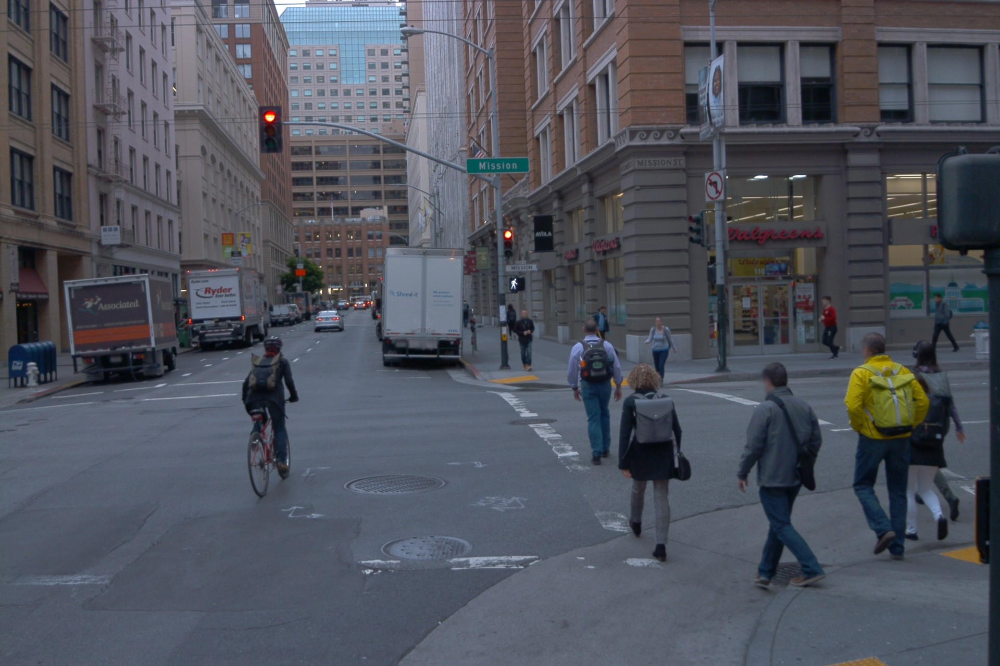

In [ ]:

import cv2
import pandas as pd
import numpy as np
from google.colab.patches import cv2_imshow

# Set the timestamp and camera name to mark the keypoints on
timestamp = 1557845092364266
camera_name = 2

# Read the camera image data
image_file = '/content/drive/MyDrive/validation/camera_image/file1.parquet'
image_data = pd.read_parquet(image_file)
image_bytes = image_data['[CameraImageComponent].image'][0]

# Create an image array from the bytes data
image = np.array(bytearray(image_bytes), dtype=np.uint8)
image = cv2.imdecode(image, cv2.IMREAD_COLOR)

# Load the camera_hkp_data
camera_hkp_file = '/content/drive/MyDrive/validation/camera_hkp/30779396576054160_1880_000_1900_000.parquet'
camera_hkp_data = pd.read_parquet(camera_hkp_file)

# Filter the camera_hkp_data based on the timestamp and camera name
filtered_hkp_data = camera_hkp_data[
    (camera_hkp_data['key.frame_timestamp_micros'] == timestamp) &
    (camera_hkp_data['key.camera_name'] == camera_name)
]

# Create an empty mask image
mask = np.zeros_like(image)

# Iterate over each object ID in the filtered data
for object_id in filtered_hkp_data['key.camera_object_id'].unique():
    # Filter the data for the current object ID
    object_data = filtered_hkp_data[
        filtered_hkp_data['key.camera_object_id'] == object_id
    ]

    # Access the x and y coordinates of the human keypoints
    x = object_data.explode('[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x')[
        '[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x'].values
    y = object_data.explode('[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y')[
        '[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y'].values

    # Draw keypoints on the mask image
    for i in range(len(x)):
        cv2.circle(mask, (int(x[i]), int(y[i])), 2, (255, 255, 255), -1)

# Apply the mask to the original image
result = cv2.addWeighted(image, 1, mask, 0.6, 0)

# Display the resulting image
cv2_imshow(result)